# Data Analysis, RIT Business Competition

# Data cleaning

In [1]:
import folium
import requests
import json
import geojson
import numpy as np
import pandas as pd
import seaborn as sns
from matplotlib import pyplot as plt
from IPython.display import HTML, display

### Shops data

In [2]:
df_info = pd.read_csv(r'pharm_info.csv')

In [3]:
df_info.head()

,storenum,storename,telephone,address1,address2,city,state,zipcode,zipcode4,longitude,latitude,website,orgname
0,2850.0,CVS - 1142,585-671-5665,1900 EMPIRE BOULEVARD,NaN,WEBSTER,NY,14580,1934.0,-77.501365,43.191229,HTTP://WWW.CVS.COM,CVS ALBANY LLC
1,2849.0,CVS - 2067,585-321-2581,2580 EAST HENRIETTA ROAD,NaN,ROCHESTER,NY,14623,4526.0,-77.606816,43.069235,HTTP://WWW.CVS.COM,CVS ALBANY LLC
2,2852.0,CVS - 2217,585-723-3051,878 LONG POND ROAD,NaN,GREECE,NY,14612,3049.0,-77.695905,43.238923,HTTP://WWW.CVS.COM,CVS ALBANY LLC
3,4603.0,CVS - 2218,585-581-5101,3750 MOUNT READ BOULEVARD,NaN,ROCHESTER,NY,14616,3436.0,-77.658331,43.227241,HTTP://WWW.CVS.COM,CVS ALBANY LLC
4,6057.0,CVS - 2501,585-426-2991,2709 CHILI AVENUE,NaN,ROCHESTER,NY,14624,4123.0,-77.709106,43.122328,HTTP://WWW.CVS.COM,CVS ALBANY LLC


In [4]:
#Dropping stores with no store numbers and coercing type
df_info = df_info.dropna(subset=['storenum'])

#Changing zipcode dtype
df_info['zipcode'] = df_info['zipcode'].astype(str)

In [5]:
df_info.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 69 entries, 0 to 68
Data columns (total 13 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   storenum   69 non-null     float64
 1   storename  69 non-null     object 
 2   telephone  69 non-null     object 
 3   address1   69 non-null     object 
 4   address2   2 non-null      object 
 5   city       69 non-null     object 
 6   state      69 non-null     object 
 7   zipcode    69 non-null     object 
 8   zipcode4   69 non-null     float64
 9   longitude  69 non-null     float64
 10  latitude   69 non-null     float64
 11  website    69 non-null     object 
 12  orgname    69 non-null     object 
dtypes: float64(4), object(9)
memory usage: 7.5+ KB


In [6]:
#Dropping columns that I don't think will be useful for data analysis
df_info = df_info.drop(['telephone','address1','address2','state','website','zipcode4'],axis = 1)

In [7]:
df_info.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 69 entries, 0 to 68
Data columns (total 7 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   storenum   69 non-null     float64
 1   storename  69 non-null     object 
 2   city       69 non-null     object 
 3   zipcode    69 non-null     object 
 4   longitude  69 non-null     float64
 5   latitude   69 non-null     float64
 6   orgname    69 non-null     object 
dtypes: float64(3), object(4)
memory usage: 4.3+ KB


### Sales data

In [8]:
df_sales = pd.read_csv(r'pharm_sales.csv')

In [9]:
df_sales.head()

,invnum,date,storenum,vendornum,itemnum,itemcategory,productcost,product_retail_price,units_sold,sales_num
0,INV-31573500023,11/2/2020,3696,259.0,11777,Food and beverages,6.63,9.95,12,120.59
1,INV-20889900001,7/29/2019,2528,260.0,10803,Diet and nutrition items,7.35,11.03,6,74.12
2,INV-20842300030,7/25/2019,5501,260.0,11294,Skin care items,8.00,12.00,4,61.44
3,INV-28440700003,7/2/2020,5057,434.0,36301,Seasonal products,4.13,6.20,3,21.39
4,INV-28440700012,7/2/2020,5057,259.0,11774,Skin care items,3.07,4.61,8,36.51


In [10]:
#Changing date column to datetime object
df_sales['date'] = pd.to_datetime(df_sales['date'])
df_sales.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 990746 entries, 0 to 990745
Data columns (total 10 columns):
 #   Column                Non-Null Count   Dtype         
---  ------                --------------   -----         
 0   invnum                990746 non-null  object        
 1   date                  990746 non-null  datetime64[ns]
 2   storenum              990746 non-null  int64         
 3   vendornum             990745 non-null  float64       
 4   itemnum               990746 non-null  int64         
 5   itemcategory          990746 non-null  object        
 6   productcost           990746 non-null  float64       
 7   product_retail_price  990746 non-null  float64       
 8   units_sold            990746 non-null  int64         
 9   sales_num             990745 non-null  float64       
dtypes: datetime64[ns](1), float64(4), int64(3), object(2)
memory usage: 75.6+ MB


### Merging the two dataframes

In [11]:
#Merging both of them using the storenumber field as that is unique for stores.

df_merged = pd.merge(df_sales, df_info, on='storenum', how = 'outer')

In [12]:
df_merged.head(3)

,invnum,date,storenum,vendornum,itemnum,itemcategory,productcost,product_retail_price,units_sold,sales_num,storename,city,zipcode,longitude,latitude,orgname
0,INV-31573500023,2020-11-02,3696,259.0,11777,Food and beverages,6.63,9.95,12,120.59,WAL-MART - 1610,GREECE,14626,-77.724197,43.214602,WAL-MART STORES EAST LP
1,INV-20309800006,2019-07-01,3696,260.0,25608,Personal hygiene,12.96,19.44,6,118.97,WAL-MART - 1610,GREECE,14626,-77.724197,43.214602,WAL-MART STORES EAST LP
2,INV-20890000006,2019-07-29,3696,297.0,35916,OTC/VMS,3.37,5.06,12,62.54,WAL-MART - 1610,GREECE,14626,-77.724197,43.214602,WAL-MART STORES EAST LP


### Renaming columns

In [13]:
df_merged = df_merged.rename(columns = {'sales_num':'revenue_original'})

In [14]:
df_merged.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 990746 entries, 0 to 990745
Data columns (total 16 columns):
 #   Column                Non-Null Count   Dtype         
---  ------                --------------   -----         
 0   invnum                990746 non-null  object        
 1   date                  990746 non-null  datetime64[ns]
 2   storenum              990746 non-null  int64         
 3   vendornum             990745 non-null  float64       
 4   itemnum               990746 non-null  int64         
 5   itemcategory          990746 non-null  object        
 6   productcost           990746 non-null  float64       
 7   product_retail_price  990746 non-null  float64       
 8   units_sold            990746 non-null  int64         
 9   revenue_original      990745 non-null  float64       
 10  storename             990746 non-null  object        
 11  city                  990746 non-null  object        
 12  zipcode               990746 non-null  object        
 13 

In [15]:
# Dropping nulls
df_merged = df_merged.dropna()

df_merged = df_merged.reset_index(drop=True)

### Adding new fields and fixing types

In [16]:
# Total cost per sale.
df_merged['total_cost'] = df_merged['productcost'] * df_merged['units_sold']

# Profit per sale
df_merged['profit'] = df_merged['revenue_original'] - df_merged['total_cost']

# Margin per unit
df_merged['margin'] = df_merged['product_retail_price'] - df_merged['productcost']

# Making store number field a string
df_merged['storenum'] = df_merged['storenum'].astype(str)

df_merged.head(3)

,invnum,date,storenum,vendornum,itemnum,itemcategory,productcost,product_retail_price,units_sold,revenue_original,storename,city,zipcode,longitude,latitude,orgname,total_cost,profit,margin
0,INV-31573500023,2020-11-02,3696,259.0,11777,Food and beverages,6.63,9.95,12,120.59,WAL-MART - 1610,GREECE,14626,-77.724197,43.214602,WAL-MART STORES EAST LP,79.56,41.03,3.32
1,INV-20309800006,2019-07-01,3696,260.0,25608,Personal hygiene,12.96,19.44,6,118.97,WAL-MART - 1610,GREECE,14626,-77.724197,43.214602,WAL-MART STORES EAST LP,77.76,41.21,6.48
2,INV-20890000006,2019-07-29,3696,297.0,35916,OTC/VMS,3.37,5.06,12,62.54,WAL-MART - 1610,GREECE,14626,-77.724197,43.214602,WAL-MART STORES EAST LP,40.44,22.10,1.69


In [17]:
df_merged.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 990744 entries, 0 to 990743
Data columns (total 19 columns):
 #   Column                Non-Null Count   Dtype         
---  ------                --------------   -----         
 0   invnum                990744 non-null  object        
 1   date                  990744 non-null  datetime64[ns]
 2   storenum              990744 non-null  object        
 3   vendornum             990744 non-null  float64       
 4   itemnum               990744 non-null  int64         
 5   itemcategory          990744 non-null  object        
 6   productcost           990744 non-null  float64       
 7   product_retail_price  990744 non-null  float64       
 8   units_sold            990744 non-null  int64         
 9   revenue_original      990744 non-null  float64       
 10  storename             990744 non-null  object        
 11  city                  990744 non-null  object        
 12  zipcode               990744 non-null  object        
 13 

#### The plot below will help me see whether I should worry too much about dropping shops or not.

If there is a huge range in variance between sales, then I should.

<AxesSubplot:xlabel='date'>

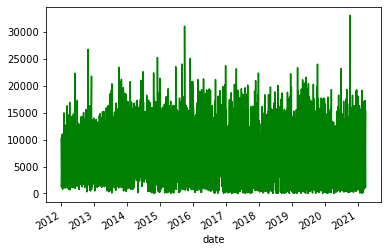

In [18]:
df_merged.groupby(['date'])['units_sold'].sum().plot(color = 'green')

Sale patterns are random, IE not that much yearly variation, thus I will drop pharmicies which made no sales in 2021, which I will assume is an indication for being closed.

### Dropping shops that probably closed.

Do we know the stores closed beyond a shadow of a doubt? No.


However doing any analysis would be moot if we don't have the data normalized in some way shape or form. It seems to me the best way to do that would be to normalize over a specific period of time. And to further normalize the data, I'll drop stores that did not have any sales past the year of 2021, then analyze with only those stores over a reasonable timeframe, where the loss of data wouldn't be too high.

In [19]:
#Making a new dataframe with only sales past 2021

df_merged_open = df_merged.loc[df_merged['date'] >= '2021-01-01']

df_merged_open = df_merged_open.reset_index(drop = True)

In [20]:
# Finding the shops that had sales in 2021, and keeping the values in a variable to assign to another dataframe later.

shops_still_open = df_merged_open['storenum'].unique()

shops_still_open

array(['3696', '2528', '5501', '5057', '5338', '5126', '2673', '4796',
       '5533', '4997', '4641', '2561', '4140', '5051', '2527', '4594',
       '2633', '2636', '2627', '4361', '2626', '4795', '5131', '2532',
       '5507', '5127', '5128', '4622', '2696', '4601', '4802', '4596',
       '5375', '4599', '4803', '4377', '4801', '4603', '5539', '2852',
       '2850', '3825', '4804', '4797', '4800', '5664', '4799', '2695',
       '5970', '5891', '6057', '6064'], dtype=object)

In [21]:
# Number of stores still open.

df_merged_open['storenum'].nunique()

52

In [22]:
52/69

0.7536231884057971

I lost 25% of the stores by only keeping the stores that were open in 2021, I need to see how much of the total dataset I will lose.

In [23]:
df_merged_final = df_merged[df_merged['storenum'].isin(shops_still_open)]

df_merged_final = df_merged_final.reset_index(drop = True)

df_merged_final.head(3)

,invnum,date,storenum,vendornum,itemnum,itemcategory,productcost,product_retail_price,units_sold,revenue_original,storename,city,zipcode,longitude,latitude,orgname,total_cost,profit,margin
0,INV-31573500023,2020-11-02,3696,259.0,11777,Food and beverages,6.63,9.95,12,120.59,WAL-MART - 1610,GREECE,14626,-77.724197,43.214602,WAL-MART STORES EAST LP,79.56,41.03,3.32
1,INV-20309800006,2019-07-01,3696,260.0,25608,Personal hygiene,12.96,19.44,6,118.97,WAL-MART - 1610,GREECE,14626,-77.724197,43.214602,WAL-MART STORES EAST LP,77.76,41.21,6.48
2,INV-20890000006,2019-07-29,3696,297.0,35916,OTC/VMS,3.37,5.06,12,62.54,WAL-MART - 1610,GREECE,14626,-77.724197,43.214602,WAL-MART STORES EAST LP,40.44,22.10,1.69


In [24]:
df_merged_final.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 910384 entries, 0 to 910383
Data columns (total 19 columns):
 #   Column                Non-Null Count   Dtype         
---  ------                --------------   -----         
 0   invnum                910384 non-null  object        
 1   date                  910384 non-null  datetime64[ns]
 2   storenum              910384 non-null  object        
 3   vendornum             910384 non-null  float64       
 4   itemnum               910384 non-null  int64         
 5   itemcategory          910384 non-null  object        
 6   productcost           910384 non-null  float64       
 7   product_retail_price  910384 non-null  float64       
 8   units_sold            910384 non-null  int64         
 9   revenue_original      910384 non-null  float64       
 10  storename             910384 non-null  object        
 11  city                  910384 non-null  object        
 12  zipcode               910384 non-null  object        
 13 

# EDA

### Where are the pharmacies?

In [25]:
m = folium.Map(location=[43.191229,-77.5], zoom_start=11) #lattitude,longitude

for latitude,longitude,storename,storenum \
in zip(df_merged_open['latitude'],df_merged_open['longitude'],df_merged_open['storename'],df_merged_open['storenum']):
    
    popup = f'{storename} - {storenum}'
    
    folium.Marker([latitude,longitude], popup= popup).add_to(m)

m

### Naive  EDA - Cities

#### Which city made the most sales?

In [26]:
df_merged.groupby(['city'])['units_sold'].sum().sort_values()

city
EAST ROCHESTER        6214
HENRIETTA            18319
HONEOYE FALLS        53312
SPENCERPORT          83386
GREECE              162429
FAIRPORT            173189
NORTH CHILI         196724
IRONDEQUOIT         292476
PENFIELD            430325
WEBSTER            1218467
ROCHESTER         12685461
Name: units_sold, dtype: int64

#### Which city made the most revenue?

In [27]:
#Gives total revenue per city.
total_revenue_city_groups = df_merged.groupby(['city']).sum().sort_values(['revenue_original'], ascending = True)['revenue_original']

total_revenue_city_groups

city
EAST ROCHESTER    5.294507e+04
HENRIETTA         3.308428e+05
HONEOYE FALLS     3.732388e+05
SPENCERPORT       4.463536e+05
NORTH CHILI       1.768509e+06
FAIRPORT          2.426044e+06
GREECE            2.573202e+06
PENFIELD          3.648242e+06
IRONDEQUOIT       4.261234e+06
WEBSTER           1.676187e+07
ROCHESTER         1.986792e+08
Name: revenue_original, dtype: float64

<AxesSubplot:title={'center':'Revenue per city'}, xlabel='city', ylabel='Total ($) '>

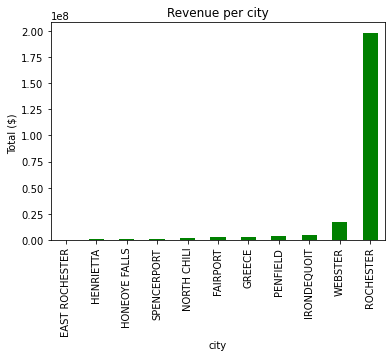

In [28]:
total_revenue_city_groups.plot(kind = 'bar',
                             color = 'green',
                            ylabel = 'Total ($) ',
                            title = 'Revenue per city'
                              )

#### Which city made the most revenue, per store?

In [29]:
# Gives number of stores per city.

number_stores_city = df_info.groupby(['city']).count()['storenum']

number_stores_city

city
EAST ROCHESTER     1
FAIRPORT           3
GREECE             2
HENRIETTA          1
HONEOYE FALLS      1
IRONDEQUOIT        2
NORTH CHILI        2
PENFIELD           3
ROCHESTER         46
SPENCERPORT        1
WEBSTER            7
Name: storenum, dtype: int64

In [30]:
# Diviging total profit per city by number of stores in that city

revenue_per_city = total_revenue_city_groups/number_stores_city
revenue_per_city

city
EAST ROCHESTER    5.294507e+04
FAIRPORT          8.086814e+05
GREECE            1.286601e+06
HENRIETTA         3.308428e+05
HONEOYE FALLS     3.732388e+05
IRONDEQUOIT       2.130617e+06
NORTH CHILI       8.842546e+05
PENFIELD          1.216081e+06
ROCHESTER         4.319113e+06
SPENCERPORT       4.463536e+05
WEBSTER           2.394552e+06
dtype: float64

<AxesSubplot:title={'center':'Average Revenue / City'}, xlabel='city', ylabel='Total ($) '>

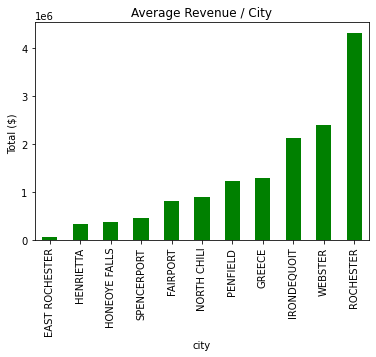

In [31]:
#Plotting average revenue/city

revenue_per_city.sort_values().plot(kind = 'bar',
                             color = 'green',
                            ylabel = 'Total ($) ',
                            title = 'Average Revenue / City')

#### Which city made the most profit?

In [32]:
total_profit_city_groups = df_merged.groupby(['city']).sum().sort_values(['profit'], ascending = True)['profit']

total_profit_city_groups.sort_values()

city
EAST ROCHESTER       23819.74
HENRIETTA           147168.46
HONEOYE FALLS       165284.03
SPENCERPORT         198562.52
NORTH CHILI         786878.96
GREECE              993381.01
FAIRPORT           1421191.68
PENFIELD           1625154.27
IRONDEQUOIT        2203673.95
WEBSTER            7688075.55
ROCHESTER         88136969.28
Name: profit, dtype: float64

<AxesSubplot:title={'center':'Profit per city'}, xlabel='city', ylabel='Total ($) '>

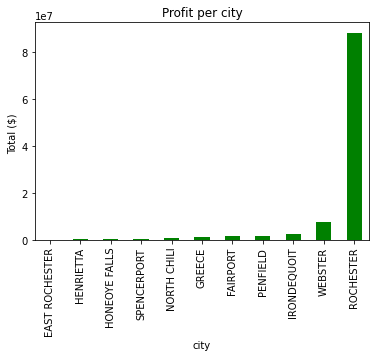

In [33]:
total_profit_city_groups.plot(kind = 'bar',
                             color = 'green',
                            ylabel = 'Total ($) ',
                            title = 'Profit per city')

#### Which city made the most average profit?

In [34]:
profit_per_city = total_profit_city_groups/number_stores_city
profit_per_city.sort_values()

city
EAST ROCHESTER    2.381974e+04
HENRIETTA         1.471685e+05
HONEOYE FALLS     1.652840e+05
SPENCERPORT       1.985625e+05
NORTH CHILI       3.934395e+05
FAIRPORT          4.737306e+05
GREECE            4.966905e+05
PENFIELD          5.417181e+05
WEBSTER           1.098297e+06
IRONDEQUOIT       1.101837e+06
ROCHESTER         1.916021e+06
dtype: float64

<AxesSubplot:title={'center':'Average Profit/ City'}, xlabel='city', ylabel='Total ($) '>

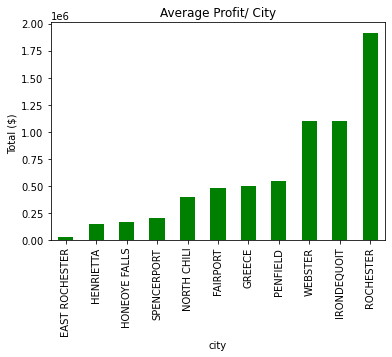

In [35]:
profit_per_city.sort_values().plot(kind = 'bar',
                             color = 'green',
                            ylabel = 'Total ($) ',
                            title = 'Average Profit/ City')

### Naive  EDA - Products

#### Which products were sold the most?

In [36]:
_sold_products = df_merged.groupby(['itemnum'])['units_sold'].sum().sort_values()

_sold_products

itemnum
87471          1
916908         1
967346         1
902021         1
916809         1
           ...  
36903     229625
37347     259822
43337     286507
89387     312512
64870     669129
Name: units_sold, Length: 5537, dtype: int64

#### Which products made the most revenue? #get rid

In [37]:
_revenue_products = df_merged.groupby(['itemnum'])['revenue_original'].sum().sort_values()

_revenue_products

itemnum
89589           6.19
992001          8.41
68800          10.15
100794         10.65
39669          10.66
             ...    
88296     4281085.31
38177     4435254.48
26827     5065575.17
11297     5338010.07
43337     5932849.25
Name: revenue_original, Length: 5537, dtype: float64

#### Which products made the most profit?

In [38]:
_profit_products = df_merged.groupby(['itemnum'])['profit'].sum().sort_values()

_profit_products

itemnum
992001      -5029.91
101181      -3728.53
12865       -1703.22
37095        -960.23
24890        -923.19
             ...    
88296     1886689.55
38177     2002026.87
26827     2226859.60
11297     2382710.09
43337     2585506.00
Name: profit, Length: 5537, dtype: float64

#### Possible product stack

In [39]:
# Initializing top 500 products.

top_sold = set(_sold_products.tail(500).index)
top_revenue = set(_revenue_products.tail(500).index)
top_profit = set(_profit_products.tail(500).index)

In [40]:
#Finding intersections to see which to prioritize

sold_revenue_intersection = top_sold & top_revenue

sold_profit_intersection = top_sold & top_profit

revenue_profit_intersection = top_revenue & top_profit

all_intersection =  top_profit & top_sold #possible stack



#### Most popular product category

<AxesSubplot:title={'center':'Most popular product category'}, xlabel='itemcategory'>

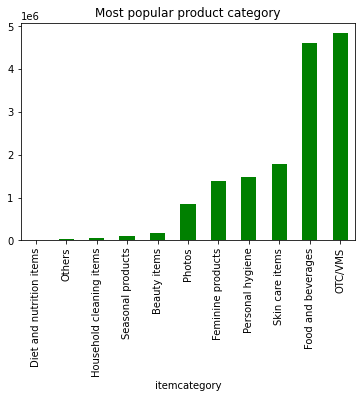

In [41]:
df_merged.groupby(['itemcategory']).sum().sort_values('units_sold')\
['units_sold'].plot(kind = 'bar', color = 'green', title = 'Most popular product category')

### Naive  EDA  - Time

#### When did the most sales occur?

<AxesSubplot:title={'center':'Totale sales over time'}, xlabel='date'>

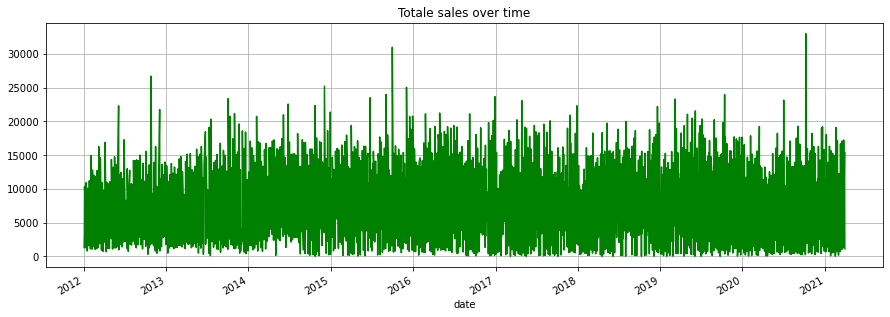

In [42]:
#Seems to me there is nothing of note here.

df_merged.groupby(['date']).sum().sort_values(by = 'date')\
['units_sold'].plot(figsize = (15,5), color = 'green', grid = True,
                   title = 'Totale sales over time')

### Naive  EDA  - Zipcode

#### Most profitible zipcode

In [43]:
total_profit_zipcode_groups = df_merged.groupby(['zipcode']).sum().sort_values(['profit'], ascending = True)['profit']

total_profit_zipcode_groups.sort_values().head(10)

zipcode
14445     23819.74
14611     97036.78
14610    110241.02
14467    147168.46
14472    165284.03
14625    181099.08
14559    198562.52
14609    214917.73
14619    264752.10
14612    307257.82
Name: profit, dtype: float64

<AxesSubplot:title={'center':'Profit per zipcode'}, xlabel='zipcode', ylabel='Total ($) '>

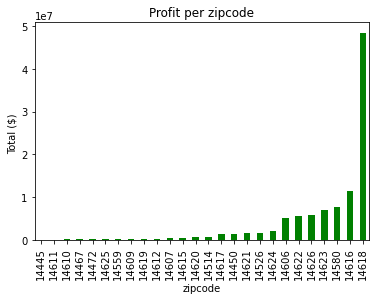

In [44]:
total_profit_zipcode_groups.plot(kind = 'bar',
                             color = 'green',
                            ylabel = 'Total ($) ',
                            title = 'Profit per zipcode')

#### Average profit per zipcode

In [45]:
number_stores_zipcode = df_info.groupby(['zipcode']).count()['storenum']

number_stores_zipcode.head(10)

zipcode
14445    1
14450    3
14467    1
14472    1
14514    2
14526    3
14559    1
14580    7
14606    4
14607    2
Name: storenum, dtype: int64

In [46]:
profit_per_zipcode = total_profit_zipcode_groups/number_stores_zipcode
profit_per_zipcode.sort_values().head()

zipcode
14445     23819.740000
14609     71639.243333
14611     97036.780000
14610    110241.020000
14467    147168.460000
dtype: float64

<AxesSubplot:title={'center':'Average Profit/ Zipcode'}, xlabel='zipcode', ylabel='Total ($) '>

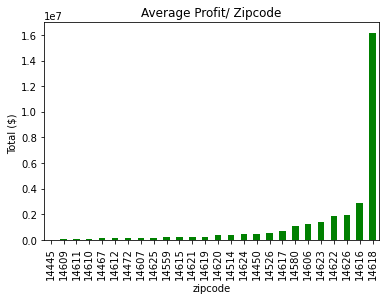

In [47]:
profit_per_zipcode.sort_values().plot(kind = 'bar',
                             color = 'green',
                            ylabel = 'Total ($) ',
                            title = 'Average Profit/ Zipcode')

### Choropleth map - Zipcode

#### Making the zipcode bounary geoJSON file

In [48]:
# Link below has all the zipcode boundaries in NY state, I'll only keep the ones I need
url='https://github.com/OpenDataDE/State-zip-code-GeoJSON/raw/master/ny_new_york_zip_codes_geo.min.json'
gj =  requests.get(url).json()

In [49]:
# Making new geojson file
ziplist = df_merged['zipcode'].unique() #list of zips in your dataframe

inziplist = []
for  ft in gj['features']:
    if ft['properties']['ZCTA5CE10'] in ziplist:
        inziplist.append(ft)
        
new_zip_json = {}
new_zip_json['type'] = 'FeatureCollection'
new_zip_json['features'] = inziplist

#### Making the map

In [50]:
profit_per_zipcode = total_profit_zipcode_groups/number_stores_zipcode

#Turning the series above into a dataframe
df_zip = pd.DataFrame({'ZCTA5CE10': [x for x in profit_per_zipcode.index],
                       'average_profit': [x for x in profit_per_zipcode.values]})

# Casting type as string so that parser can parse connect it to geojson file
df_zip['ZCTA5CE10'] = df_zip['ZCTA5CE10']

m = folium.Map(location=[43.191229,-77.5], zoom_start=11, tile = 'stamenwatercolor')



style_function = "font-size: 15px; font-weight: bold"

choropleth = folium.Choropleth(
    geo_data = new_zip_json,
    name = "choropleth",
    data = df_zip,
    columns = ['ZCTA5CE10', 'average_profit'],
    key_on = 'feature.properties.ZCTA5CE10',
    fill_color = "YlGn",
    fill_opacity = 4,
    line_opacity = 2,
    legend_name = "Average profit",
    labels = True
).add_to(m)


# add labels indicating zipcode
style_function = "font-size: 15px; font-weight: bold"
choropleth.geojson.add_child(
    folium.features.GeoJsonTooltip(['ZCTA5CE10'], style=style_function, labels=False))


folium.LayerControl().add_to(m)

m

### Zipcode profitiblity heatmap

In [51]:
df_zip = df_zip.rename(columns = {'ZCTA5CE10': 'zipcode'})
df_zip.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 26 entries, 0 to 25
Data columns (total 2 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   zipcode         26 non-null     object 
 1   average_profit  26 non-null     float64
dtypes: float64(1), object(1)
memory usage: 544.0+ bytes


In [52]:
df_demographics = pd.read_csv('zip_demographics.csv')

df_demographics['zipcode'] = df_demographics['zipcode'].astype(str)

df_demographics.head()

,zipcode,CurrentPopulation,RacialMajority,UnemploymentRate,MedianHouseholdIncome,AverageAdjustedGrossIncome,SchoolTestPerformance,Area,SchoolRacialMajority,SchoolRacialMajorityPercentage,RacialMajorityPercentage
0,14580,50587,White,5.3,75618.0,81510.0,Above Average,44.0,White,87.1,90.24
1,14623,27173,White,5.5,54283.0,49130.0,Above Average,20.0,White,56.0,71.17
2,14612,34515,White,7.3,62148.0,61510.0,Average,17.0,White,69.2,86.99
3,14616,28534,White,10.8,55438.0,46270.0,Above Average,6.0,White,67.2,82.20
4,14624,36296,White,6.5,69312.0,62360.0,Average,28.0,White,66.6,81.99


In [53]:
df_demographics.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 25 entries, 0 to 24
Data columns (total 11 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   zipcode                         25 non-null     object 
 1   CurrentPopulation               25 non-null     int64  
 2   RacialMajority                  25 non-null     object 
 3   UnemploymentRate                25 non-null     float64
 4   MedianHouseholdIncome           25 non-null     float64
 5   AverageAdjustedGrossIncome      25 non-null     float64
 6   SchoolTestPerformance           25 non-null     object 
 7   Area                            25 non-null     float64
 8   SchoolRacialMajority            25 non-null     object 
 9   SchoolRacialMajorityPercentage  25 non-null     float64
 10  RacialMajorityPercentage        25 non-null     float64
dtypes: float64(6), int64(1), object(4)
memory usage: 2.3+ KB


In [54]:
df_zips_merged = pd.merge(df_demographics, df_zip, on='zipcode', how = 'outer')

df_zips_merged.head()

,zipcode,CurrentPopulation,RacialMajority,UnemploymentRate,MedianHouseholdIncome,AverageAdjustedGrossIncome,SchoolTestPerformance,Area,SchoolRacialMajority,SchoolRacialMajorityPercentage,RacialMajorityPercentage,average_profit
0,14580,50587.0,White,5.3,75618.0,81510.0,Above Average,44.0,White,87.1,90.24,1.098297e+06
1,14623,27173.0,White,5.5,54283.0,49130.0,Above Average,20.0,White,56.0,71.17,1.396503e+06
2,14612,34515.0,White,7.3,62148.0,61510.0,Average,17.0,White,69.2,86.99,1.536289e+05
3,14616,28534.0,White,10.8,55438.0,46270.0,Above Average,6.0,White,67.2,82.20,2.888253e+06
4,14624,36296.0,White,6.5,69312.0,62360.0,Average,28.0,White,66.6,81.99,4.248745e+05


In [55]:
df_zip_num = df_zips_merged.select_dtypes(include = ['float64', 'int64'])

df_zip_num.head()

,CurrentPopulation,UnemploymentRate,MedianHouseholdIncome,AverageAdjustedGrossIncome,Area,SchoolRacialMajorityPercentage,RacialMajorityPercentage,average_profit
0,50587.0,5.3,75618.0,81510.0,44.0,87.1,90.24,1.098297e+06
1,27173.0,5.5,54283.0,49130.0,20.0,56.0,71.17,1.396503e+06
2,34515.0,7.3,62148.0,61510.0,17.0,69.2,86.99,1.536289e+05
3,28534.0,10.8,55438.0,46270.0,6.0,67.2,82.20,2.888253e+06
4,36296.0,6.5,69312.0,62360.0,28.0,66.6,81.99,4.248745e+05


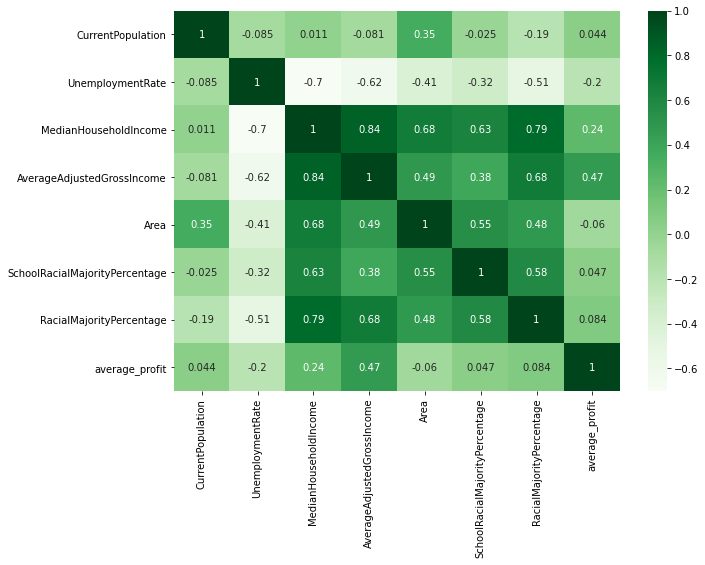

In [56]:
plt.rcParams['figure.figsize'] = [10,7]
ax = sns.heatmap(df_zip_num.corr(), annot=True, cmap = "Greens")

### Naive  EDA  -  Stores

#### Most profitible stores




Keep in mind some stores have the same name, so we should check by store number as well.

In [57]:
total_profit_store_groups = df_merged.groupby(['storename']).sum().sort_values(['profit'], ascending = True)['profit']

total_profit_store_groups.sort_values().head()

storename
CVS - 653          7083.03
RITE AID - 621     8819.08
CVS - 831         24445.47
RITE AID - 623    34914.47
RITE AID - 629    51987.58
Name: profit, dtype: float64

<AxesSubplot:title={'center':'Profit / Store'}, xlabel='storename', ylabel='Total ($) '>

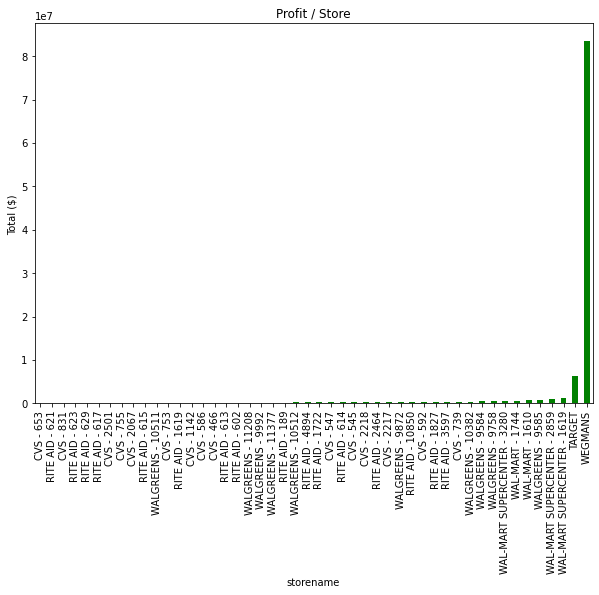

In [58]:
total_profit_store_groups.sort_values().plot(kind = 'bar',
                             color = 'green',
                            ylabel = 'Total ($) ',
                            title = 'Profit / Store')

#### Average profit per store

In [59]:
number_stores = df_info.groupby(['storename']).count()['storenum']

number_stores.sort_values().tail(10)

storename
CVS - 831            1
RITE AID - 10850     1
RITE AID - 1619      1
RITE AID - 1722      1
RITE AID - 1827      1
RITE AID - 189       1
RITE AID - 2464      1
RITE AID - 4894      1
TARGET               6
WEGMANS             17
Name: storenum, dtype: int64

In [60]:
profit_per_store = total_profit_store_groups/number_stores
profit_per_store.sort_values().tail(10)

storename
WALGREENS - 9584               4.653579e+05
WALGREENS - 9758               5.204847e+05
WAL-MART SUPERCENTER - 3280    5.962654e+05
WAL-MART - 1744                6.676577e+05
WAL-MART - 1610                6.989474e+05
WALGREENS - 9585               7.623609e+05
WAL-MART SUPERCENTER - 2859    1.002671e+06
TARGET                         1.045015e+06
WAL-MART SUPERCENTER - 1619    1.153745e+06
WEGMANS                        4.912098e+06
dtype: float64

<AxesSubplot:title={'center':'Average profit / Store'}, xlabel='storename', ylabel='Total ($) '>

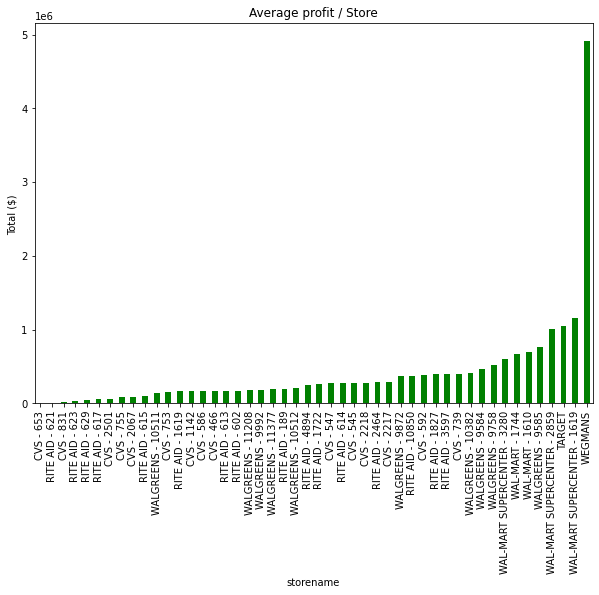

In [61]:
profit_per_store.sort_values().plot(kind = 'bar',
                             color = 'green',
                            ylabel = 'Total ($) ',
                            title = 'Average profit / Store')

#### Store number analysis

In [62]:
total_profit_store_num = df_merged.groupby(['storenum']).sum().sort_values(['profit'], ascending = True)['profit']

total_profit_store_num.sort_values().head()

storenum
5970     7083.03
6064     8819.08
2695    12824.22
5137    23819.74
5032    24445.47
Name: profit, dtype: float64

<AxesSubplot:title={'center':'Profit / Store (number)'}, xlabel='storenum', ylabel='Total ($) '>

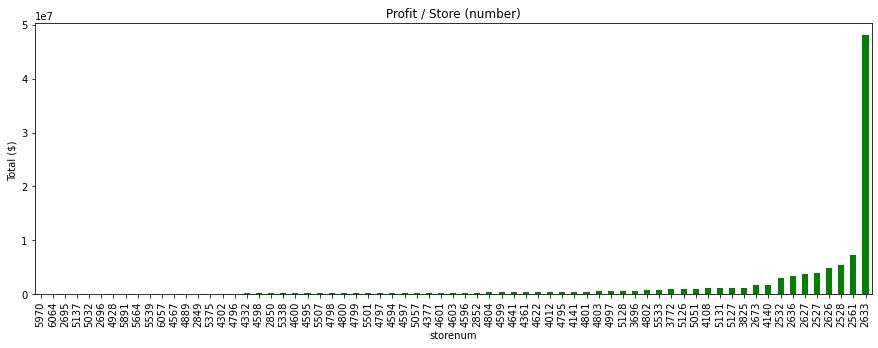

In [63]:
total_profit_store_num.sort_values().plot(kind = 'bar',
                             color = 'green',
                            ylabel = 'Total ($) ',
                            title = 'Profit / Store (number)',
                                         figsize = (15,5))

#### Store analysis by number of sales


In [64]:
total_sales = df_merged.groupby(['storenum']).count().sort_values(by = 'units_sold')['units_sold']

total_sales

storenum
6064       139
2695       252
5970       276
2696       452
5664       537
         ...  
2627     54747
2626     61290
2528     64364
2561     85299
2633    176596
Name: units_sold, Length: 69, dtype: int64

<AxesSubplot:title={'center':'Profit / Store (number)/ Sale'}, xlabel='storenum', ylabel='Total ($) '>

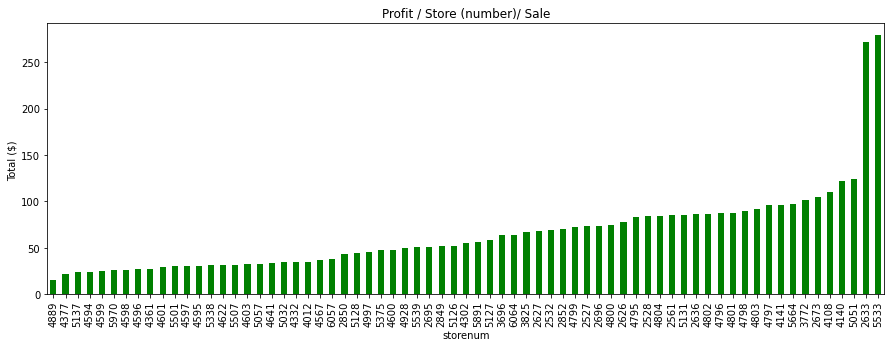

In [65]:
normarlized_profit_store = total_profit_store_num/total_sales


normarlized_profit_store.sort_values().plot(kind = 'bar',
                             color = 'green',
                            ylabel = 'Total ($) ',
                            title = 'Profit / Store (number)/ Sale',
                                         figsize = (15,5))

### Naive  EDA  -  Vendors

In [66]:
total_profit_vendors = df_merged.groupby(['vendornum']).sum().sort_values(['profit'], ascending = True)['profit']

total_profit_vendors.sort_values()

vendornum
143.0         -34.27
324.0           9.04
290.0          11.17
298.0          11.92
341.0          21.00
            ...     
434.0     7003114.63
65.0      7474523.72
421.0     8040020.74
370.0     8126272.42
260.0    21294070.67
Name: profit, Length: 220, dtype: float64

In [67]:
sales_per_vendor = df_merged.groupby(['vendornum']).sum()['units_sold']

sales_per_vendor.sort_values()

vendornum
290.0          1
324.0          1
80.0           2
298.0          2
516.0          3
          ...   
115.0     932708
65.0     1031176
434.0    1549874
421.0    1790417
260.0    2283823
Name: units_sold, Length: 220, dtype: int64

In [68]:
average_profit_vendor = total_profit_vendors/sales_per_vendor

average_profit_vendor.sort_values().tail()

vendornum
547.0    49.278611
472.0    58.553704
80.0     63.045000
104.0    65.626667
446.0    80.482000
dtype: float64

<AxesSubplot:title={'center':'Profit / vendor (number)'}, xlabel='vendornum', ylabel='Total ($) '>

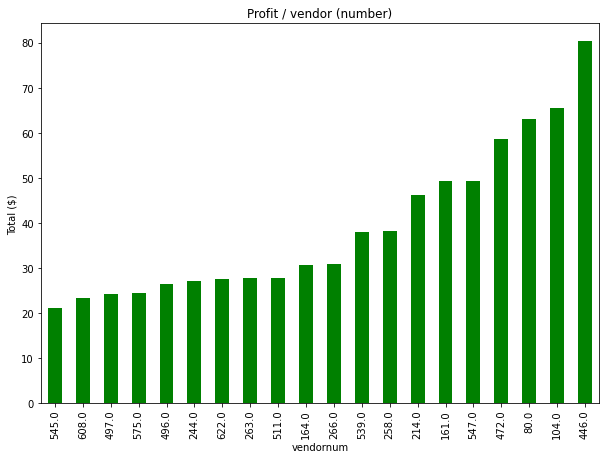

In [69]:
average_profit_vendor.sort_values().tail(20).plot(kind = 'bar',
                             color = 'green',
                            ylabel = 'Total ($) ',
                            title = 'Profit / vendor (number)'
                                        )

### Product stack in most profitable store

In [70]:
# Only looking at most profitible store
most_profitible_store = df_merged.loc[df_merged['storenum'] == '2633' ]

#Unique products
unique_products_most_profitible_store = set(most_profitible_store['itemnum'])


#Intersection between most profitible overall products
len(top_profit & unique_products_most_profitible_store)

383

The most profitible has 383/411 of the products that happen to be the most profitible so it would make sense to suggest products not availabel in the store.

In [71]:
# Profitible products not available at store # 2633
(products_to_suggest := np.array(top_profit - unique_products_most_profitible_store))

array({25604, 41989, 36873, 11786, 36886, 43031, 43036, 11293, 68126, 27680, 49185, 49189, 36901, 36903, 36904, 10804, 10805, 100423, 80458, 35914, 35916, 28236, 35416, 52312, 52314, 52316, 36965, 36967, 36968, 37993, 37994, 36974, 89199, 36976, 36978, 43123, 12404, 43124, 43126, 19063, 38006, 38008, 44658, 34423, 43136, 16518, 22155, 40592, 40598, 34456, 65200, 89786, 45246, 26820, 26824, 38088, 26826, 84172, 45276, 5346, 65253, 65254, 89836, 13038, 31472, 22784, 40192, 22786, 4866, 1799, 86796, 23826, 34578, 43285, 25878, 10008, 20248, 57125, 81206, 27453, 45886, 43336, 64862, 64863, 64865, 82786, 86884, 86886, 64870, 52593, 52594, 34164, 52596, 56195, 3984, 31656, 34746, 67526, 36301, 36305, 36306, 53210, 37339, 53211, 53213, 53214, 48101, 48102, 32232, 32233, 32234, 32236, 32238, 35314, 35316, 11773, 11774},
      dtype=object)

## Analyzing profits of all shops over time

storenum  date      
2527      2012-01-05    [AxesSubplot(0.125,0.2;0.775x0.68)]
          2012-01-12    [AxesSubplot(0.125,0.2;0.775x0.68)]
          2012-01-19    [AxesSubplot(0.125,0.2;0.775x0.68)]
          2012-01-26    [AxesSubplot(0.125,0.2;0.775x0.68)]
          2012-02-01    [AxesSubplot(0.125,0.2;0.775x0.68)]
                                       ...                 
6057      2021-03-25    [AxesSubplot(0.125,0.2;0.775x0.68)]
6064      2020-12-18    [AxesSubplot(0.125,0.2;0.775x0.68)]
          2021-01-22    [AxesSubplot(0.125,0.2;0.775x0.68)]
          2021-02-19    [AxesSubplot(0.125,0.2;0.775x0.68)]
          2021-03-12    [AxesSubplot(0.125,0.2;0.775x0.68)]
Name: profit, Length: 20777, dtype: object

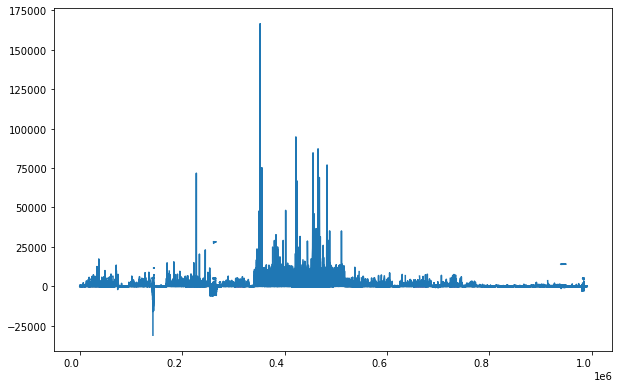

In [72]:
profit_over_time = df_merged.groupby(['storenum','date'])['profit']

profit_over_time.plot(subplots = True)